In [210]:
import time, os

# Numpy
import numpy as np
import scipy
import sklearn
import pandas as pd

# Tensorflow and keras layers
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.layers import Input, Dense,\
                                    Activation, ZeroPadding2D,\
                                    BatchNormalization, Flatten, Conv2D, Conv2DTranspose
from tensorflow.keras.layers import AveragePooling2D, MaxPooling2D,\
                                    Dropout, GlobalMaxPooling2D,\
                                    GlobalAveragePooling2D
from tensorflow.keras.models import Model, load_model
from tensorflow.keras import activations
from tensorflow.keras import backend
from tensorflow.keras import layers

# To generate GIFs


import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import PIL

from datetime import datetime

from tqdm import tqdm

import IPython
from IPython import display
import ipywidgets as widgets

import ngraph_bridge
from tensorflow.core.protobuf import rewriter_config_pb2
from tensorflow.python.tools import freeze_graph
import json

from numpy.random import seed
from tensorflow import set_random_seed

def reset_seed():
    # Making results reproducible
    seed(10092)
    set_random_seed(10093)  

# Auxiliary Code

In [17]:
def create_dir(dirname):
    try:
        # Create target Directory
        os.mkdir(dirname)
        #print("dirname " , filename ,  " Created ") 
    except FileExistsError:
        print("Directory " , dirname ,  " already exists")

create_dir('models')

def preprocess_real_samples(samples):
    samples = samples.astype('float32').reshape(-1, 28, 28, 1)
    samples = (samples - samples.min()) / (samples.max() - samples.min())
    return samples


def plot_4_by_4_images(x, save = False, savefile="img.png"):
    w=10
    h=10
    fig=plt.figure(figsize=(w, h))
    columns = 4
    rows = 5
    for i in range(1, columns*rows +1):
        img = np.random.randint(x.shape[0])
        fig.add_subplot(rows, columns, i)
        plt.imshow(x[i - 1, :, :, 0], cmap='gray')
    if save:
        plt.savefig(savefile)
    plt.show()
    plt.close()


def plot_image(img):
    plt.imshow(img, cmap='gray')
    plt.show()
    
def generate_noise_samples(n=1):
    noise = np.random.normal(0, 1, (n, 100))
    return noise


def generate_fake_samples(generator, n=1):
    noise = generate_noise_samples(n)
    X = generator.predict(noise)
    return X


def generate_and_save_images(generator, noise_test, epoch, filename):
    display.clear_output(wait=True)
    fake_images = generator.predict(noise_test)
    plot_4_by_4_images(fake_images, save=True, savefile='models/{}/img/{:04d}.png'.format(filename, epoch))

    
def train_step(generator, discriminator, gan, real_images, batch_size=64):
    real_label = np.ones((batch_size, 1))
    generated_images = generate_fake_samples(generator, batch_size)
    generated_labels = np.zeros((batch_size, 1))

    X_dis = np.concatenate([real_images, generated_images])
    y_dis = np.zeros(2*batch_size)
    y_dis[:batch_size]=0.9
        
    discriminator.trainable = True
    discriminator.train_on_batch(X_dis, y_dis)
    #discriminator.train_on_batch(x_fake, y_fake)
        
    discriminator.trainable = False
    x_gan = generate_noise_samples(batch_size)
    y_gan = np.ones((batch_size, 1)) # We assume that we wanted true as answer from the discriminator
    gan.train_on_batch(x_gan, y_gan)

def gen_csv(data_list, filename):
    pd.DataFrame(data_list, 
                 columns =['Epoch', 'Time (s)']).to_csv ('models/%s/times.csv'%(filename), index = False, header=True)

def train(generator, discriminator, gan, dataset, epochs=50, batch_size=64, filename=str(int(time.time())), clear=False):
    m = dataset.shape[0]
    # We check for the number of epochs the NN trained already for
    trained_epochs = len(os.listdir('models/%s/img' % (filename))) if clear == True else 0
    m_batch = m // batch_size
    noise_test = np.random.normal(0,1, [20, 100]) 
    toc = time.time()
    time_data = []
    for epoch in range(epochs):
        tic = time.time()
        for batch_num in range(m_batch):
            tuc = time.time()
                #if batch_num % 30 == 0:
                #print ('[{}%] Time for epoch {} is {} sec'.format((batch_num / m_batch) 
                #* 100,epoch + 1, time.time()-tic), end='\r')
                #generate_and_save_images(noise_test, epoch, batch_num)
            print("[%0.2f%%] Time for epoch %d is %f sec" % ( (batch_num / m_batch) * 100, epoch + 1, time.time()-tic), end='\r')
            
            batch_slot = batch_size * batch_num
            batch = dataset[batch_slot: batch_slot + batch_size]
            train_step(generator, discriminator, gan, batch, batch_size)
        time_data.append((epoch + 1, time.time()-tic))
        generate_and_save_images(generator, noise_test, epoch, filename)
        print ('Time for epoch {} is {} sec'.format(trained_epochs + epoch + 1, time_data[-1][1]))
    
    gen_csv(time_data, filename)
    generator.save('models/%s/generator.h5' % (filename))
    discriminator.save('models/%s/discriminator.h5' % (filename))
    gan.save('models/%s/gan.h5' % (filename))

    
def make_gif(anim_file, file_regex):
    #anim_file = 'dcgan.gif'
    fname = None
    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob(file_regex)
        filenames = sorted(filenames)
        last = -1
        for i,filename in enumerate(filenames):
            frame = 2*(i**0.75)
            if round(frame) > round(last):
                last = frame
            else:
                continue
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

        
def format_filename(filename):
    date = datetime.now()
    date_str = "_%02d_%02d_%02d_%02d_%02d" % (date.day, date.month, date.year, date.hour, date.minute)
    create_dir('models/'+ filename)
    create_dir('models/'+ filename +"/img")
    return filename

def plot_vs(x, ys, errors, title):
    fig=plt.figure(figsize=(10, 8))
    Y = ys[0]
    for y in ys:
        plt.plot(X, y[0], label=y[1])

    for y in ys[1:]:
        plt.plot(X, np.abs(Y[0] - y[0]), label='Error %s vs %s' % (Y[1], y[1]), color='crimson')
    plt.xlabel(title)
    plt.axhline(y=0, color='k', linestyle=':', linewidth=1)
    plt.axvline(x=0, color='k', linestyle=':', linewidth=1)
    plt.legend()

Directory  models  already exists


# Code for Intel nGraph HE Transformer

In [18]:
def print_nodes(graph_def=None):
    """Prints the node names of a graph_def.
        If graph_def is not provided, use default graph_def"""

    if graph_def is None:
        nodes = [n.name for n in tf.get_default_graph().as_graph_def().node]
    else:
        nodes = [n.name for n in graph_def.node]

    print("nodes", nodes)

# https://www.dlology.com/blog/how-to-convert-trained-keras-model-to-tensorflow-and-make-prediction/
def freeze_session(session,
                   keep_var_names=None,
                   output_names=None,
                   clear_devices=True):
    """
    Freezes the state of a session into a pruned computation graph.

    Creates a new computation graph where variable nodes are replaced by
    constants taking their current value in the session. The new graph will be
    pruned so subgraphs that are not necessary to compute the requested
    outputs are removed.
    @param session The TensorFlow session to be frozen.
    @param keep_var_names A list of variable names that should not be frozen,
                          or None to freeze all the variables in the graph.
    @param output_names Names of the relevant graph outputs.
    @param clear_devices Remove the device directives from the graph for better portability.
    @return The frozen graph definition.
    """
    from tensorflow.python.framework.graph_util import (
        convert_variables_to_constants,
        remove_training_nodes,
    )

    graph = session.graph
    with graph.as_default():
        freeze_var_names = list(
            set(v.op.name for v in tf.global_variables()).difference(
                keep_var_names or []))
        output_names = output_names or []
        output_names += [v.op.name for v in tf.global_variables()]
        # Graph -> GraphDef ProtoBuf
        input_graph_def = graph.as_graph_def()
        #print_nodes(input_graph_def)
        if clear_devices:
            for node in input_graph_def.node:
                node.device = ""
        frozen_graph = convert_variables_to_constants(
            session, input_graph_def, output_names, freeze_var_names)
        frozen_graph = remove_training_nodes(frozen_graph)
        return frozen_graph

def save_model(sess, output_names, directory, filename):
    frozen_graph = freeze_session(sess, output_names=output_names)
    #print_nodes(frozen_graph)
    tf.io.write_graph(frozen_graph, directory, filename + ".pb", as_text=False)
    print("Model saved to: %s" % filename + ".pb")

    
def load_pb_file(filename):
    """"Returns the graph_def from a saved protobuf file"""
    if not os.path.isfile(filename):
        raise Exception("File, " + filename + " does not exist")

    with tf.io.gfile.GFile(filename, "rb") as f:
        graph_def = tf.compat.v1.GraphDef()
        graph_def.ParseFromString(f.read())

    print("Model restored")
    return graph_def

In [19]:
def get_N(total_coefficient_modulus_bit_width, security_level, sec_type='classical'):
    sec = {
        'classical':{
            128:{
                1024:  27,
                2048:  54,
                4096:  109,
                8192:  218,
                16384: 438,
                32768: 881
            },
            192:{
                1024:  19,
                2048:  37,
                4096:  75,
                8192:  152,
                16384: 305,
                32768: 611
            },
            256:{
                1024:  14,
                2048:  29,
                4096:  58,
                8192:  118,
                16384: 237,
                32768: 476
            }
        },
        'quantum':{
           128:{
                1024:  25,
                2048:  51,
                4096:  101,
                8192:  202,
                16384: 411,
                32768: 827
            },
            192:{
                1024:  17,
                2048:  35,
                4096:  70,
                8192:  141,
                16384: 284,
                32768: 571
            },
            256:{
                1024:  13,
                2048:  27,
                4096:  54,
                8192:  109,
                16384: 220,
                32768: 443
            }
        }
    }
    log2q_prev = 0
    for n, log2q in sec[sec_type][security_level].items():
        if log2q_prev < total_coefficient_modulus_bit_width < log2q:
            return n
        log2q_prev = log2q
    return n

def define_encryption_params(security_level, L):
    # Select the security level
    # Compute the multiplicative depth of the computational graph
    #L = 8 # Assumed from configuration
    # Estimate the bit-precission s, required. According to Intel, the best tradeoff is ~24 bits
    s = 24
    # Choose the coeff_modulus = [s, s, s, ..., s]. A list of L coefficient moduli, each with s bits. Set the scale to s.
    coeff_modulus = [s] * L
    coeff_modulus[0] = 30
    coeff_modulus[-1] = 30
    scale = s
    # Compute the total coefficient modulus bit width, L * s in the above parameter selection.
    total_coefficient_modulus_bit_width = L * s
    # Set the poly_modulus_degree to the smallest power of two, with coefficient modulus smaller than the maximum allowed.
    # Based on the table of recommended parameters. 
    N = get_N(total_coefficient_modulus_bit_width, security_level)
    poly_modulus_degree = N
    # For best performance, we should choose the batch_size to max_batch_size
    max_batch_size = poly_modulus_degree / 2
    # We should only include the complex packing if there are polynomial activations.
    # That is, if we make use of our own activation functions
    complex_packing = False
    
    enc_params = {
        'scheme_name': 'HE_SEAL',          # Fixed, to use the HE backend
        'poly_modulus_degree': poly_modulus_degree,       # A power of 2 {1024, 2048, 4096, 8192, 16384}
        'security_level': security_level,             # The security we want to ensure {0, 128, 192, 256}
        'coeff_modulus': coeff_modulus, # A number inbetween 1 and 60
        'scale': 2 ** s,                  # The fixed bit precission of the encoding. (log2(scale) is the number of bits)
        'complex_packing': complex_packing,
    }
    print(enc_params)
    return enc_params
def gen_json_params_file(filename, security_level=128, L=8):
    enc_params_dict = define_encryption_params(security_level, L)
    enc_params_json = json.dumps(enc_params_dict)
    with open(filename, 'w+') as file:
        file.write(enc_params_json)
    print("Generated configuration in %s" %(filename))
    
gen_json_params_file('config.json', security_level=128, L=8)

"""python test.py --batch_size=100 \
               --backend=HE_SEAL \
               --model_file=models/cryptonets.pb \
               --encrypt_server_data=true \
               --encryption_parameters=$HE_TRANSFORMER/configs/he_seal_ckks_config_N13_L8.json
"""
def get_config_for_ngraph_server(tensor_param_name):
    rewriter_options = rewriter_config_pb2.RewriterConfig()
    rewriter_options.meta_optimizer_iterations = rewriter_config_pb2.RewriterConfig.ONE
    rewriter_options.min_graph_nodes = -1
    server_config = rewriter_options.custom_optimizers.add()
    server_config.name = "ngraph-optimizer"
    server_config.parameter_map["ngraph_backend"].s = b'HE_SEAL'
    server_config.parameter_map["device_id"].s = b""
    server_config.parameter_map["encryption_parameters"].s = b'config.json'
    server_config.parameter_map["enable_client"].s = b'false'
    # Only server
    server_config.parameter_map[tensor_param_name].s = b"encrypt"
    # With client
    #server_config.parameter_map[tensor_param_name].s = b"client_input"
    # Pack data
    server_config.parameter_map[tensor_param_name].s += b",packed"

    config = tf.compat.v1.ConfigProto()
    config.MergeFrom(
            tf.compat.v1.ConfigProto(
                graph_options=tf.compat.v1.GraphOptions(
                    rewrite_options=rewriter_options)))
    return config

{'scheme_name': 'HE_SEAL', 'poly_modulus_degree': 8192, 'security_level': 128, 'coeff_modulus': [30, 24, 24, 24, 24, 24, 24, 30], 'scale': 16777216, 'complex_packing': False}
Generated configuration in config.json


# Full training functions

In [20]:
def full_training(generator_mod, discriminator_mod, gan_mod, n, epochs, batch_size, filename):
    # Make results reproducible
    reset_seed()
    filename = format_filename(filename)
    
    # Load dataset
    dataset = np.load('apple.npy')
    dataset = preprocess_real_samples(dataset) 
    #plot_4_by_4_images(dataset)
    
    generator = generator_mod()

    discriminator = discriminator_mod()

    gan = gan_mod(generator, discriminator)
    
    train(generator, discriminator, gan, dataset[:n], epochs, batch_size, filename)
    make_gif('models/%s/apple.gif'%(filename), "models/%s/img/*.png"%(filename))
    
    return 'models/%s/apple.gif'%(filename)

def retrain(generator_mod, discriminator_mod, gan_mod, n, epochs, batch_size, filename):

    # Make results reproducible
    reset_seed()
    filename = format_filename(filename)

    prefix = "models/%s/" % (filename)
    generator = tf.keras.models.load_model(prefix +'generator.h5') \
                if type(generator_mod) is str \
                else generator_mod()
    discriminator = tf.keras.models.load_model(prefix +'discriminator.h5') \
                    if type(generator_mod) is str \
                    else discriminator_mod()
    gan = tf.keras.models.load_model(prefix +'gan.h5') \
            if type(generator_mod) is str \
            else gan_mod(generator, discriminator)
    
    # Load dataset
    dataset = np.load('apple.npy')
    dataset = preprocess_real_samples(dataset) 
    #plot_4_by_4_images(dataset)
    
    
    train(generator, discriminator, gan, dataset[:n], epochs, batch_size, filename)
    make_gif('models/%s/apple.gif'%(filename), "models/%s/img/*.png"%(filename))
    
    return 'models/%s/apple.gif'%(filename)

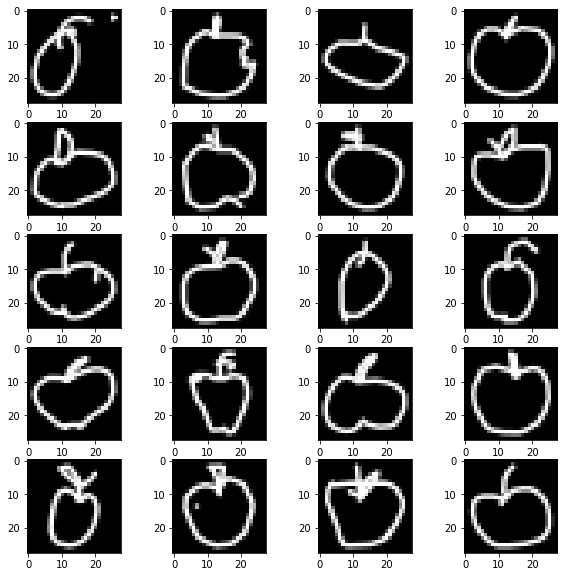

In [21]:
plot_4_by_4_images(preprocess_real_samples(np.load('apple.npy')))

# Activation Functions Approximations

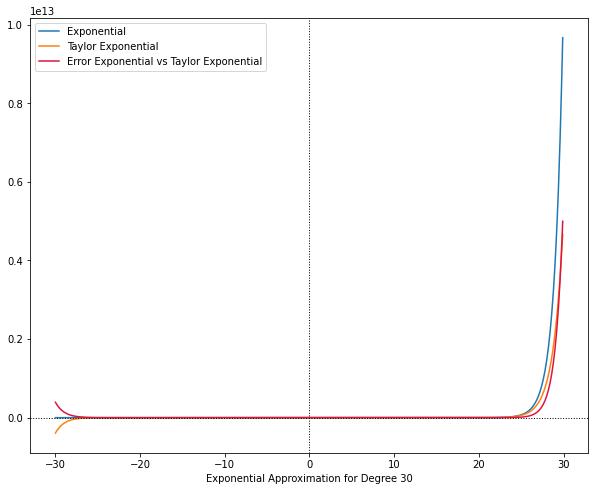

In [22]:
def taylor_exp(x, n=9):
    result = 1
    for i in range(1, n):
        result += ((x ** i) / (np.math.factorial(i)))
    return result 

r = 30
X = np.array(np.arange(-r, r, 0.1))
Y = np.exp(X)
Y_hat = np.array([taylor_exp(x, 30) for x  in X]) 
ys = [(Y, "Exponential"), (Y_hat, "Taylor Exponential")]
errors = [np.abs(Y - y[0]) for y in ys[1:]]
plot_vs(X, ys, errors, "Exponential Approximation for Degree 30")

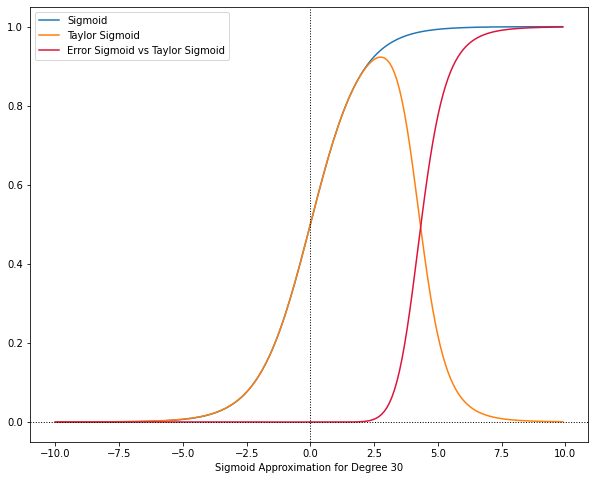

In [211]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def taylor_sigmoid(x, n=9):
    return 1 / (1 + taylor_exp(-x, n))

r = 10
X = np.array(np.arange(-r, r, 0.1))
Y = sigmoid(X)
Y_hat = np.array([taylor_sigmoid(x, 9) for x  in X]) 
ys = [(Y, "Sigmoid"), (Y_hat, "Taylor Sigmoid")]
errors = [np.abs(Y - y[0]) for y in ys[1:]]
plot_vs(X, ys, errors, "Sigmoid Approximation for Degree 30")

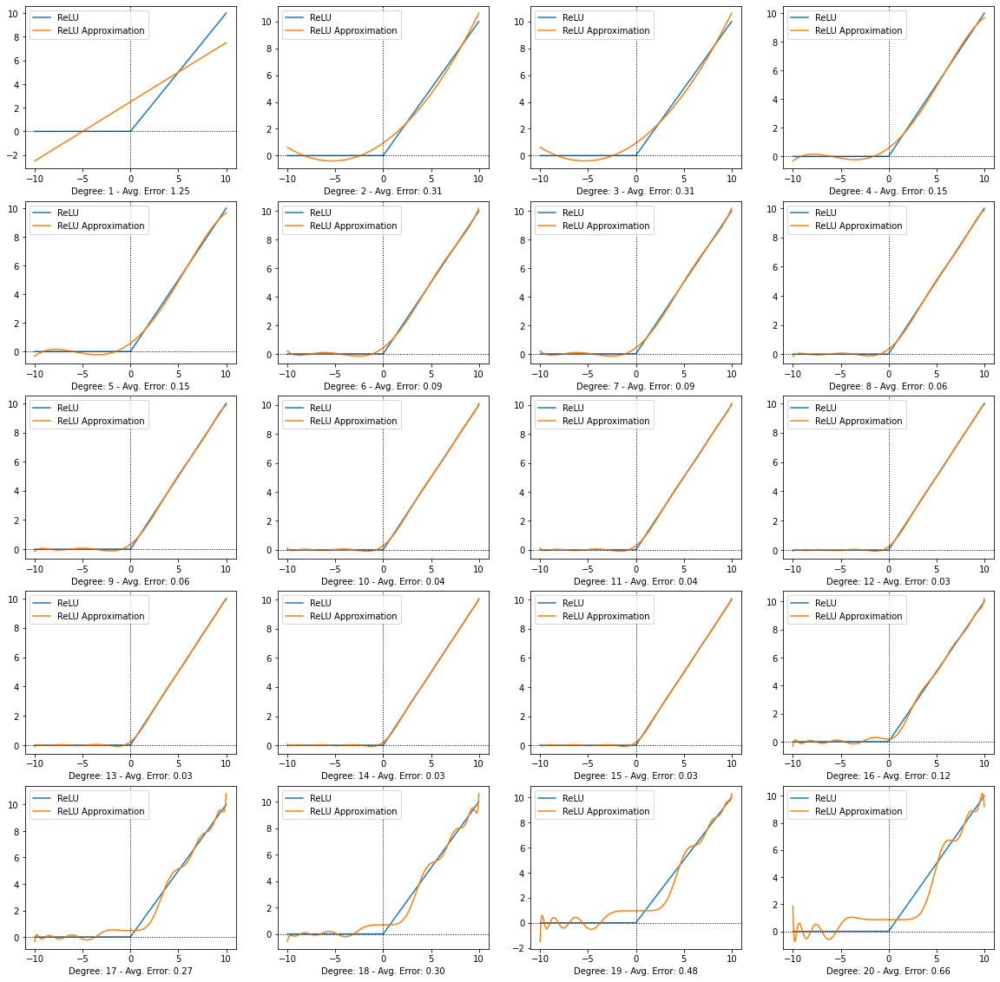

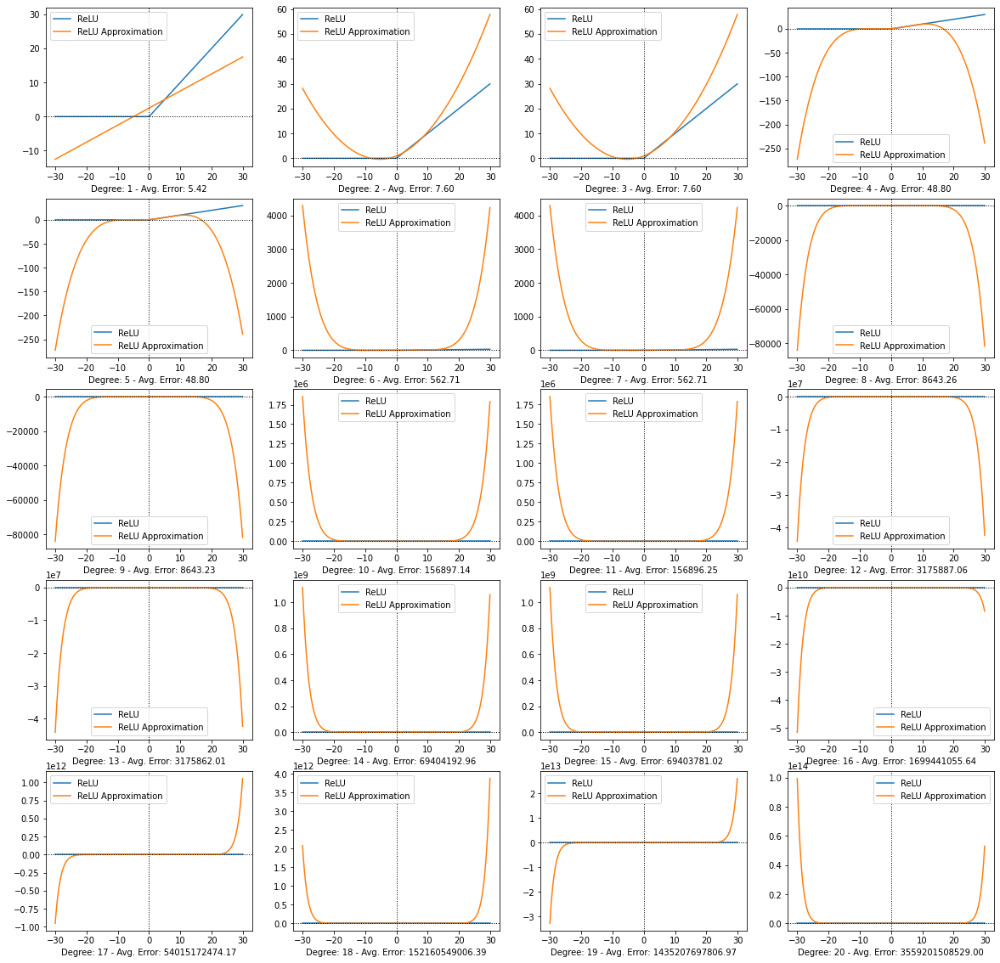

In [24]:
from sklearn.linear_model import LinearRegression, Ridge

def expand_power(X, n):
    if n < 2:
        return X.reshape(1, len(X)).T
    Xt = X
    for i in range(2, n+1):
        Xn = X ** i
        Xt = np.concatenate([Xt, Xn])
    Xt = Xt.reshape(n, len(X)).T
    return Xt
    
def approximate_with_linear_regression(function, n = 9, r=10):
    if n == 0:
        print("ERROR")
        return
    
    #X = np.concatenate([np.arange(-1, 0, 10 ** -5), np.arange(0, 1, (10 ** -4) / 2)])
    X = np.arange(-r, r, 10**-4)
    Y = np.array([relu(i) for i in X])
    
    Xt = expand_power(X, n)
    
    
    #reg = Ridge(alpha=0.5).fit(Xt, Y)
    reg = LinearRegression().fit(Xt, Y)
    Y_hat = reg.predict(Xt)
    #print("Degree %d" % (n), reg.score(Xt, Y))

    return reg, X, Y, Y_hat


def approximate_in_range(function, reg, r, n = 9):
    Xt = np.arange(-r, r, 10**-1)
    return Xt, [function(x) for x in Xt], reg.predict(expand_power(Xt, n))
    
def plot_graphs(X, Ys, config=(3,3)):
    w=20
    h=20
    fig=plt.figure(figsize=(w, h))
    columns = config[0]
    rows = config[1]
    for i in range(1, columns*rows +1):
        if i > len(Ys) - 1:
            break
        fig.add_subplot(rows, columns, i)
        err = np.abs(Ys[0]- Ys[i])
        plt.plot(X, Ys[0], label='ReLU')
        plt.plot(X, Ys[i], label='ReLU Approximation')
        #plt.plot(X, err, label='Error', color='crimson')
        plt.xlabel('Degree: %d - Avg. Error: %0.2f' % (i, np.mean(err)))
        plt.axhline(y=0, color='k', linestyle=':', linewidth=1)
        plt.axvline(x=0, color='k', linestyle=':', linewidth=1)
        
        plt.legend()

    plt.show()
    plt.title('Approximations of ReLU function')
    plt.close()

# We define the ReLU function
relu = lambda x: max(x, 0)

# List of Y_predicted
Ys = list()
Ys2 = list()
coeffs = list()
regs = []
for degree  in range(1, 21):
    reg, X, Y, Y_hat = approximate_with_linear_regression(relu, degree)
    regs.append(reg)
    Xt, Yt, Yt_hat = approximate_in_range(relu, reg, 3 * 10, degree)
    
    if len(Ys) == 0:
        Ys.append(Y)
        Ys2.append(Yt)
    Ys.append(Y_hat)
    Ys2.append(Yt_hat)
    #print(reg.coef_, reg.intercept_)
# Plot the configuration
plot_graphs(X, Ys, config=(4, 5))
plot_graphs(Xt, Ys2, config=(4, 5))

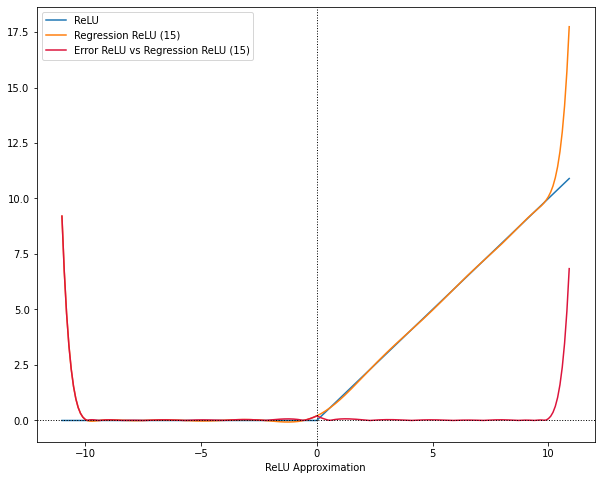

In [25]:
def relu(x):
    return max(0, x)

def relu_regression_15(x):
    coeffs = [ 4.98607867e-01,  2.44760805e-01,  1.12783842e-04, -1.55015242e-02,
              -3.47795219e-06,  6.51064944e-04,  2.93417664e-08, -1.52801044e-05,
              -7.18060376e-11,  1.98075434e-07,  1.28426949e-12, -1.32595939e-09,
              -1.14535118e-14,  3.57549382e-12,  2.77555756e-17]
    result = 0.20568957267320265
    for i, coef in enumerate(coeffs):
        result += (x ** (i+1)) * coef 
    return result

r = 11
X = np.array(np.arange(-r, r, 0.1))
Y = np.array([relu(x) for x  in X]) 
Y_hat = np.array([relu_regression_15(x) for x  in X]) 
ys = [(Y, "ReLU"), (Y_hat, "Regression ReLU (15)")]
errors = [np.abs(Y - y[0]) for y in ys[1:]]
plot_vs(X, ys, errors, "ReLU Approximation")

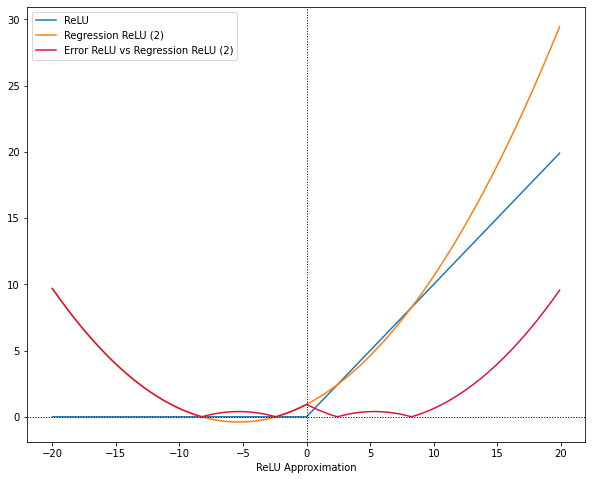

In [26]:
def relu_regression_2(x):
    coeffs = [0.5000009, 0.046875]
    result = 0.9375000043248491
    for i, coef in enumerate(coeffs):
        result += (x ** (i+1)) * coef 
    return result 

r = 20
X = np.array(np.arange(-r, r, 0.1))
Y = np.array([relu(x) for x  in X]) 
Y_hat = np.array([relu_regression_2(x) for x  in X]) 
ys = [(Y, "ReLU"), (Y_hat, "Regression ReLU (2)")]
errors = [np.abs(Y - y[0]) for y in ys[1:]]
plot_vs(X, ys, errors, "ReLU Approximation")

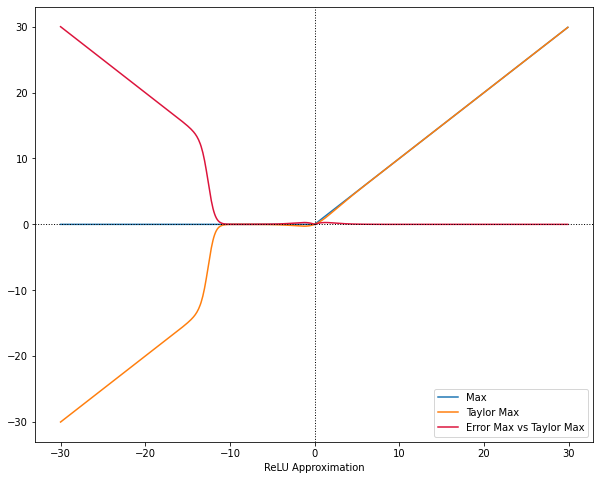

In [27]:
def taylor_max(x,y,k=1):
    ekx = taylor_exp(k * x, 31)
    eky = taylor_exp(k * y, 31)
    return (x * ekx + y * eky) / (ekx + eky)

def approxmax(x, y, k=10):
    ekx = np.exp(k * x)
    eky = np.exp(k * y)
    return (x * ekx + y * eky) / (ekx + eky)

r = 30
X = np.array(np.arange(-r, r, 0.1))
Y = np.array([max(x,0) for x  in X]) 
#Y_hat = np.array([approxmax(x, 0) for x  in X])
Y_hat2 = np.array([taylor_max(x, 0) for x  in X]) 
ys = [(Y, "Max"), (Y_hat2, "Taylor Max")]
errors = [np.abs(Y - y[0]) for y in ys[1:]]
plot_vs(X, ys, errors, "ReLU Approximation")

/root/he-transformer/build/ext_ngraph_tf/src/ext_ngraph_tf/build_cmake/venv-tf-py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log
  # This is added back by InteractiveShellApp.init_path()


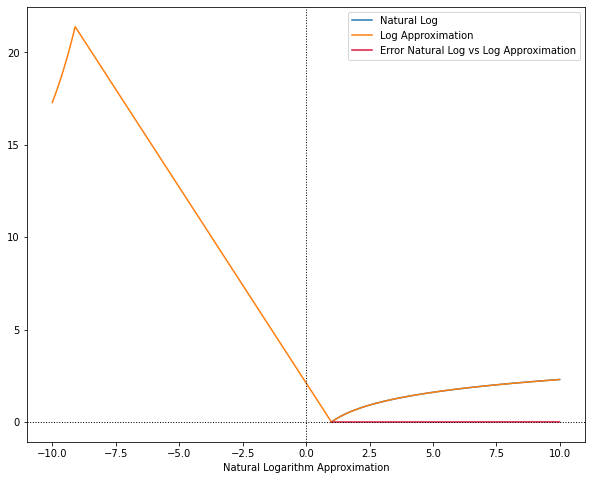

In [174]:
def taylor_ln(x, degree=9):
    result = 0
    for n in range(degree):
        t = (2 * n) + 1
        result += ((1 / t) * (((x - 1)/(x + 1))** t))
    return 2 * result

degree = 9
r = 10
X = np.concatenate([np.arange(-r, -9, 10**-1), np.arange(1, r, 10 ** -2)])
Y = [np.log(x) for x in X]
Y_hat = np.array([taylor_ln(i, degree) for i in X])
ys = [(Y, "Natural Log"), (Y_hat, "Log Approximation")]
errors = [np.abs(Y - y[0]) for y in ys[1:]]
plot_vs(X, ys, errors, "Natural Logarithm Approximation")

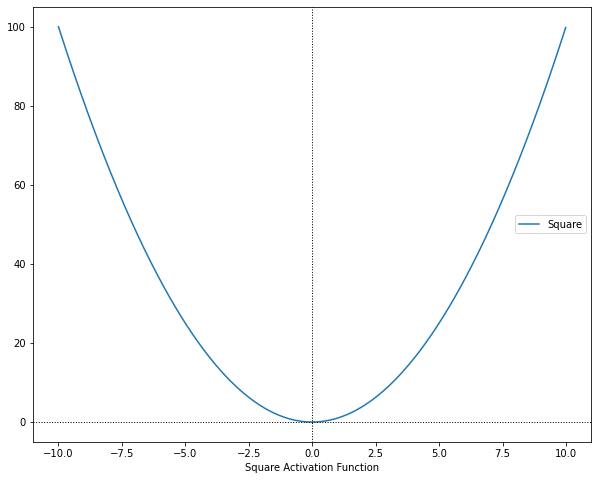

In [29]:
def square_activation(x):
    return x * x

r = 10
X = np.arange(-r, r, 10 ** -2)
Y = [square_activation(x) for x in X]

ys = [(Y, "Square")]
errors = [np.abs(Y - y[0]) for y in ys[1:]]
plot_vs(X, ys, errors, "Square Activation Function")

### ReLU approximation in CryptoDL

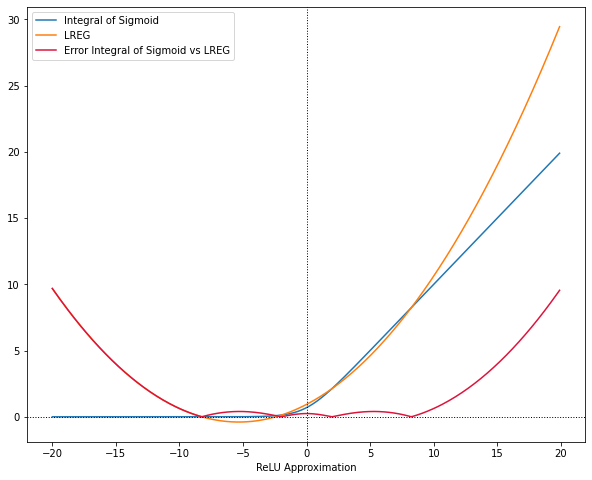

In [193]:
import sympy as sp

def integrate_sigmoid():
    x = sp.Symbol('x')
    return sp.integrate(1 / (1 + sp.exp(-x)), x)
    
integrate_sigmoid()
def integral_sigmoid(x):
    return x + np.log(1 + np.exp(-x))


def taylor_integral_sigmoid(x, degree=9):
    return x + taylor_ln(1 + taylor_exp(-x, degree), degree)
n = 3
reg, _, _, _ = approximate_with_linear_regression(integral_sigmoid, n, r=10)
r = 20
X = np.array(np.arange(-r, r, 0.1))
Y = np.array([integral_sigmoid(x) for x  in X]) 
Y_hat = reg.predict(expand_power(X, n))
#Y_hat2 = np.array([taylor_integral_sigmoid(x, 30) for x  in X]) 
ys = [(Y, "Integral of Sigmoid"), (Y_hat, "LREG")]#, (Y_hat2, "Integral of Sigmoid Approx")]
errors = [np.abs(Y - y[0]) for y in ys[1:]]
plot_vs(X, ys, errors, "ReLU Approximation")

# Training neural networks with HIDDEN activations

## BASE MODEL


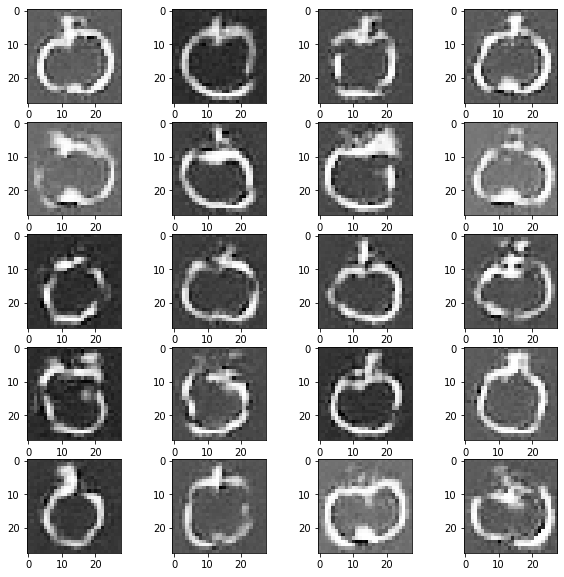

Time for epoch 50 is 12.715396881103516 sec


In [13]:
def generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,), name='input_gen'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    #model.add(Activation(square_activation))

    model.add(layers.Reshape((7, 7, 256)))
    assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 7, 7, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    #model.add(Activation(square_activation))    

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 14, 14, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    #model.add(Activation(square_activation))
    
    model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', 
                                     use_bias=False, activation='tanh', 
                                     name='output_gen'))
    assert model.output_shape == (None, 28, 28, 1)
    #model.compile(loss='binary_crossentropy', optimizer='adam')
    model.compile(loss='binary_crossentropy', optimizer='sgd')
    return model


def discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[28, 28, 1], name='input_disc'))
    model.add(layers.LeakyReLU())
    #model.add(Activation(square_activation))
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    #model.add(Activation(square_activation))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1, activation='sigmoid', name='output_disc'))
    #model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    model.compile(loss='binary_crossentropy', optimizer='sgd')
    return model


def gan_model(generator, discriminator):
    discriminator.trainable=False
    gan_input = Input(shape=(100,))
    x = generator(gan_input)
    gan_output = discriminator(x)
    gan= Model(inputs=gan_input, outputs=gan_output)
    #gan.compile(loss='binary_crossentropy', optimizer='adam')
    gan.compile(loss='binary_crossentropy', optimizer='sgd')
    return gan

    
animation = full_training(generator_model, discriminator_model, gan_model, 5000, 50, 32, 'basic_1')

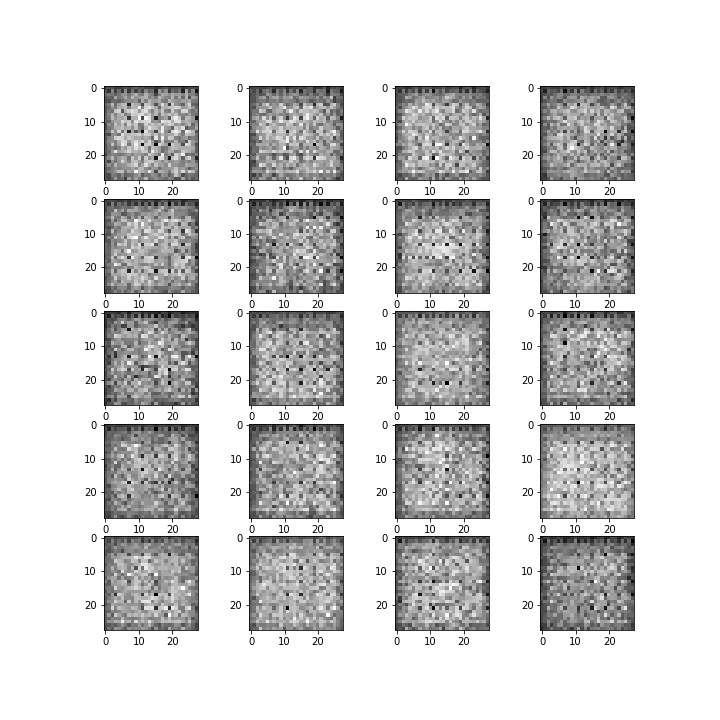

In [14]:
display.Image(filename=animation)

In [15]:
def generator_model_act(activation):

    model = tf.keras.Sequential()
    model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,), name='input_gen'))
    model.add(layers.BatchNormalization())
    model.add(Activation(activation)) ##Change with respect to previous

    model.add(layers.Reshape((7, 7, 256)))
    assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 7, 7, 128)
    model.add(layers.BatchNormalization())
    model.add(Activation(activation)) ##Change with respect to previous 

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 14, 14, 64)
    model.add(layers.BatchNormalization())
    model.add(Activation(activation)) ##Change with respect to previous
    
    model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', 
                                     use_bias=False, activation='tanh', 
                                     name='output_gen'))
    #model.add(Activation(activation)) ##Change with respect to previous
    assert model.output_shape == (None, 28, 28, 1)
    model.compile(loss='binary_crossentropy', optimizer='sgd')
    
    return model


def discriminator_model_act(activation):

    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[28, 28, 1], name='input_disc'))
    model.add(Activation(activation)) ##Change with respect to previous
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(Activation(activation)) ##Change with respect to previous
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1, activation='sigmoid', name='output_disc'))
    #model.add(Activation(activation)) ##Change with respect to previous
    model.compile(loss='binary_crossentropy', 
                  optimizer='sgd',
                  metrics=['accuracy'])
    return model


def gan_model_act(generator, discriminator):
    discriminator.trainable=False
    gan_input = Input(shape=(100,))
    x = generator(gan_input)
    gan_output = discriminator(x)
    gan= Model(inputs=gan_input, outputs=gan_output)
    #gan.compile(loss='binary_crossentropy', optimizer='adam')
    gan.compile(loss='binary_crossentropy', 
                optimizer='sgd')
    return gan
            
              
def test_activation_function(function):
    generator_act = lambda: generator_model_act(function)
    dicriminator_act = lambda: discriminator_model_act(function)
    gan_act = gan_model_act
    return generator_act, dicriminator_act, gan_act

## Using the square function (Most Efficient) (only hidden)
In the code below, we train the adversarial network making use of the square function as activation function. It provides the advantage that it is really efficient in the "encrypted" domain, however, the results do not seem to be promising or the neural network to be learning.

Although it seems to work, at times, the exploding gradient problem comes. Due to the fact that the $x^2$ squares numbers, all numbers inbetween 0 and 1 get reduced ($-1 <= x <= 1$), but numbers bigger than 1 ($x > 1$) or smaller than -1 ($x < -1$) , get highly increased.


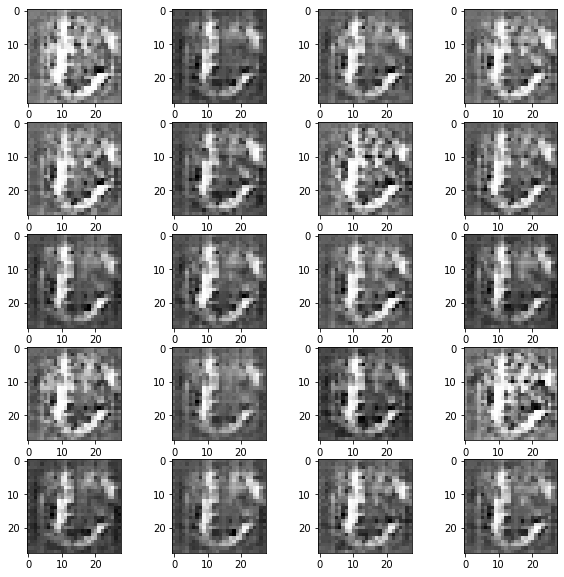

Time for epoch 50 is 13.186601638793945 sec


In [17]:
gen_model_act, disc_mod_act, gan_mod_act = test_activation_function(square_activation)
animation2 = full_training(gen_model_act, disc_mod_act, gan_mod_act, 5000, 50, 32, 'square2')

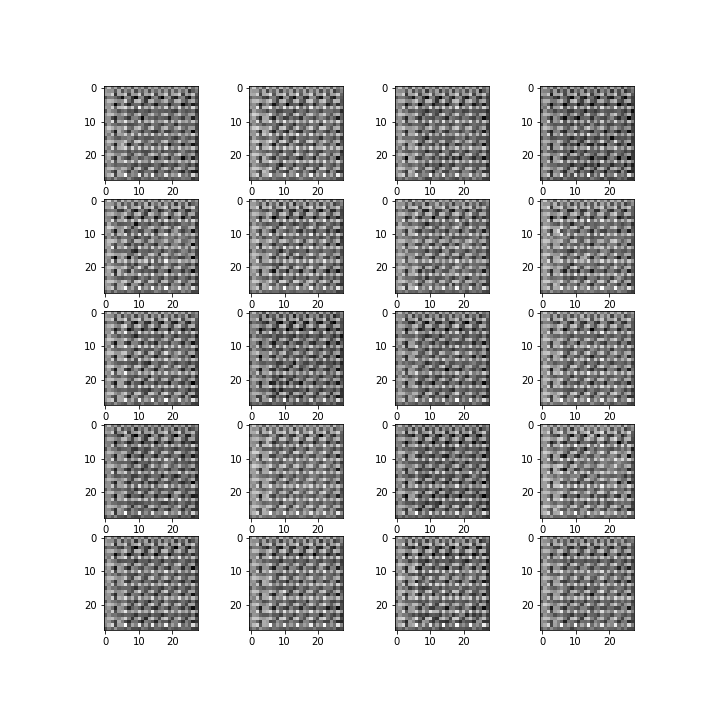

In [18]:
animation2 = 'models/square/apple.gif'
display.Image(filename=animation2)

## Using the taylor approximation for sigmoid (only hidden)
In the code below, we train the adversarial network making use of the sigmoid taylor polynomial approximation.

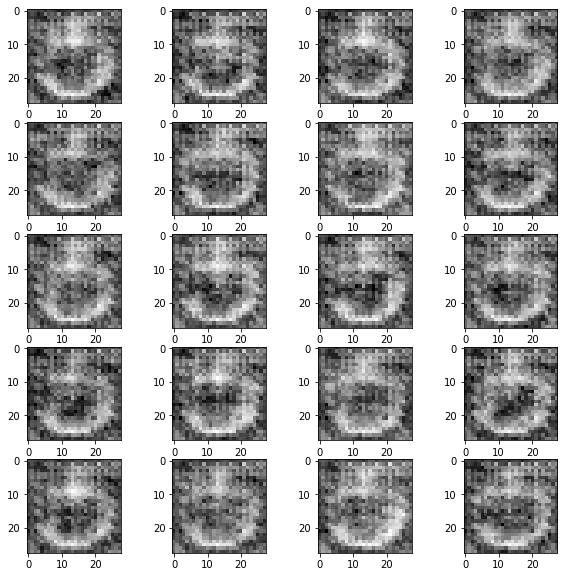

Time for epoch 50 is 16.463956832885742 sec


In [18]:
gen_model_act, disc_mod_act, gan_mod_act = test_activation_function(taylor_sigmoid)
animation3 = full_training(gen_model_act, disc_mod_act, gan_mod_act, 5000, 50, 32, 'taylor_sigmoid')

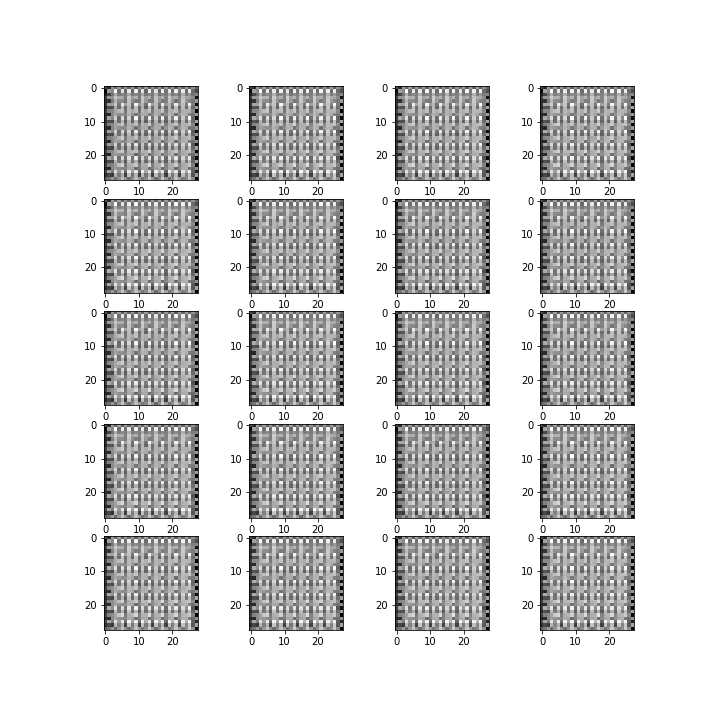

In [19]:
display.Image(filename=animation3)

## Trying the ReLU regression as activation function d=2 (only hidden)

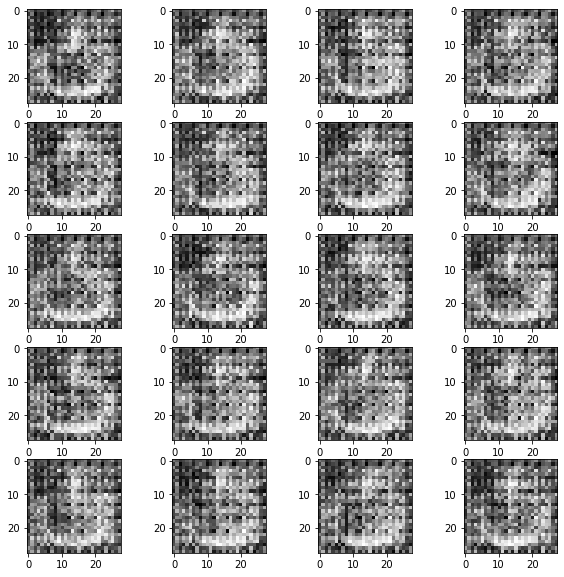

Time for epoch 50 is 13.477971315383911 sec


In [21]:
gen_model_act, disc_mod_act, gan_mod_act = test_activation_function(relu_regression_2)
animation4 = full_training(gen_model_act, disc_mod_act, gan_mod_act, 5000, 50, 32, 'relu_regression_2')

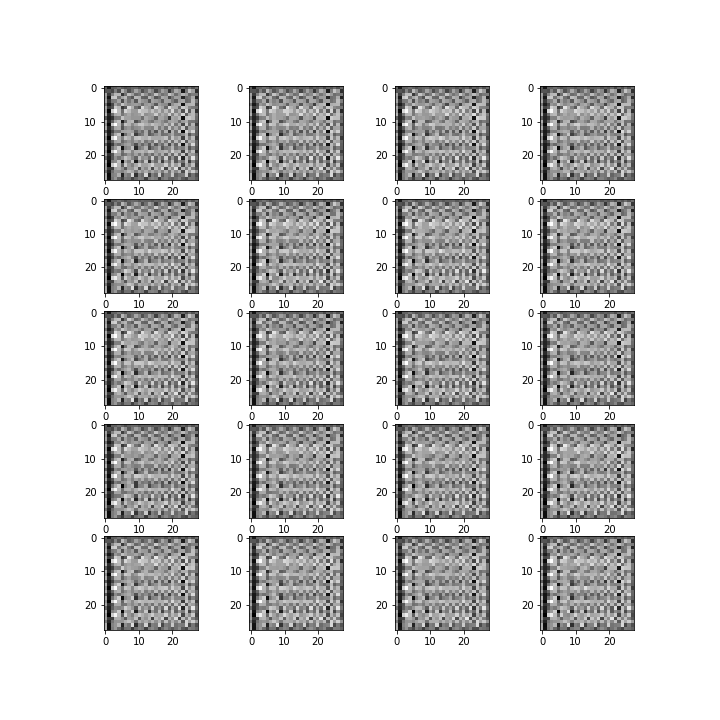

In [22]:
display.Image(filename=animation4)

## Trying the ReLU regression as activation function d=15 (only hidden)

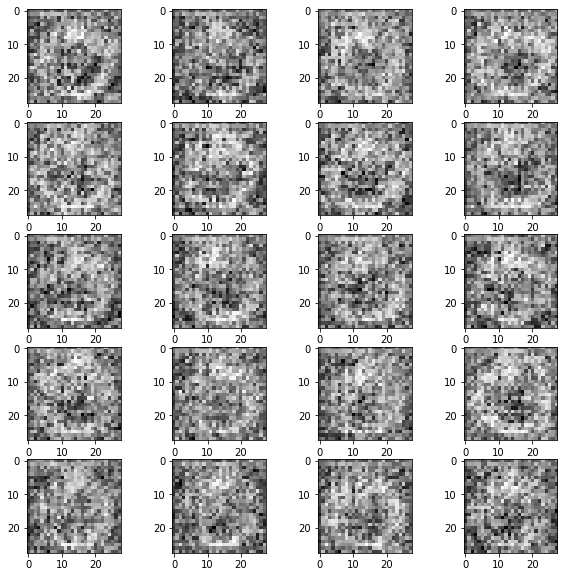

Time for epoch 50 is 19.625179767608643 sec


In [25]:
gen_model_act, disc_mod_act, gan_mod_act = test_activation_function(relu_regression_15)
animation5 = full_training(gen_model_act, disc_mod_act, gan_mod_act, 5000, 50, 32, 'relu_regression_15')

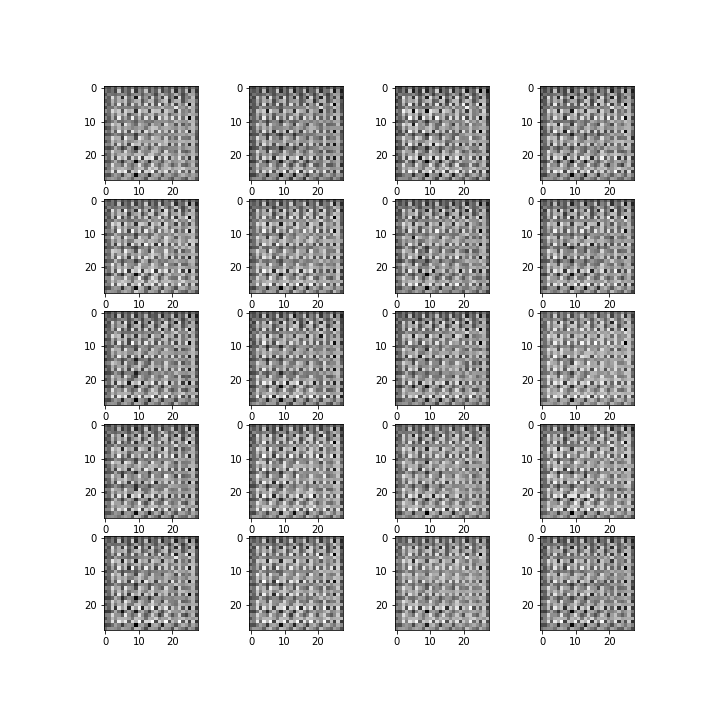

In [26]:
display.Image(filename=animation5)

# Private inference

In [20]:
def private_pred(model, x):
    custom_functions = {'relu_regression_2': relu_regression_2,
                        'relu_regression_15': relu_regression_15,
                        'taylor_sigmoid': taylor_sigmoid,
                        'square_activation': square_activation}
    # Reset the graph and backend learning phase.
    tf.reset_default_graph()
    tf.keras.backend.set_learning_phase(0)
    
    # Load generator as H5
    generator = tf.keras.models.load_model('models/%s/generator.h5' % (model), 
                                           custom_objects=custom_functions)
    print("Loaded %s model    " % (model))
        # Save model as PB
    save_model(tf.compat.v1.keras.backend.get_session(), 
               ["output_gen/conv2d_transpose"], "./models/%s/"%(model), 
               model)

    
    # Reset again the default graph
    tf.reset_default_graph()
    tf.keras.backend.set_learning_phase(0)

    
    tf.import_graph_def(load_pb_file("./models/%s/%s.pb"%(model, model)))  
    
    x_input = tf.compat.v1.get_default_graph().get_tensor_by_name('import/input_gen_input:0')
    y_output = tf.compat.v1.get_default_graph().get_tensor_by_name('import/output_gen/conv2d_transpose:0')
    print_nodes()
    config = get_config_for_ngraph_server(x_input.name)
    with tf.compat.v1.Session(config=config) as sess:
        print("Executing new comp")
        sess.run(tf.compat.v1.global_variables_initializer())
        start_time = time.time()
        y_hat = y_output.eval(feed_dict={x_input: x })
        y_pred = np.tanh(y_hat)
        elasped_time = time.time() - start_time
        print("Total time(s)", np.round(elasped_time, 3))
        return y_pred

def private_pred2(model, x):
    custom_functions = {'relu_regression_2': relu_regression_2,
                        'relu_regression_15': relu_regression_15,
                        'taylor_sigmoid': taylor_sigmoid,
                        'square_activation': square_activation}
    # Reset the graph and backend learning phase.
    tf.reset_default_graph()
    tf.keras.backend.set_learning_phase(0)
    
    # Load generator as H5
    discriminator = tf.keras.models.load_model('models/%s/discriminator.h5' % (model), 
                                           custom_objects=custom_functions)
    #print_nodes()
    print("Loaded %s model    " % (model))
        # Save model as PB
    save_model(tf.compat.v1.keras.backend.get_session(), 
               ["output_disc/BiasAdd"], "./models/%s/"%(model), 
               model)

    
    # Reset again the default graph
    tf.reset_default_graph()
    tf.keras.backend.set_learning_phase(0)

    
    tf.import_graph_def(load_pb_file("./models/%s/%s.pb"%(model, model)))  
    
    x_input = tf.compat.v1.get_default_graph().get_tensor_by_name('import/input_disc_input:0')
    y_output = tf.compat.v1.get_default_graph().get_tensor_by_name('import/output_disc/BiasAdd:0')
    print_nodes()
    config = get_config_for_ngraph_server(x_input.name)
    with tf.compat.v1.Session(config=config) as sess:
        print("Executing new comp")
        sess.run(tf.compat.v1.global_variables_initializer())
        start_time = time.time()
        y_hat = y_output.eval(feed_dict={x_input: x })
        y_pred = np.tanh(y_hat)
        elasped_time = time.time() - start_time
        print("Total time(s)", np.round(elasped_time, 3))
        return y_pred
y_pred = private_pred2('square2', np.random.normal(0, 1, [1, 28, 28, 1]))    

Loaded square2 model    
Model saved to: square2.pb
Model restored
nodes ['import/input_disc_input', 'import/input_disc/kernel', 'import/input_disc/bias', 'import/input_disc/Conv2D', 'import/input_disc/BiasAdd', 'import/activation_8/mul', 'import/conv2d_1/kernel', 'import/conv2d_1/bias', 'import/conv2d_1/Conv2D', 'import/conv2d_1/BiasAdd', 'import/activation_9/mul', 'import/flatten_1/Shape', 'import/flatten_1/strided_slice/stack', 'import/flatten_1/strided_slice/stack_1', 'import/flatten_1/strided_slice/stack_2', 'import/flatten_1/strided_slice', 'import/flatten_1/Reshape/shape/1', 'import/flatten_1/Reshape/shape', 'import/flatten_1/Reshape', 'import/output_disc/kernel', 'import/output_disc/bias', 'import/output_disc/MatMul', 'import/output_disc/BiasAdd', 'import/SGD/iter', 'import/SGD/decay', 'import/SGD/learning_rate', 'import/SGD/momentum']
Executing new comp
Total time(s) 309.861


In [ ]:
%%time
y_pred = private_pred2('square2', np.random.normal(0, 1, [1, 28, 28, 1]))    

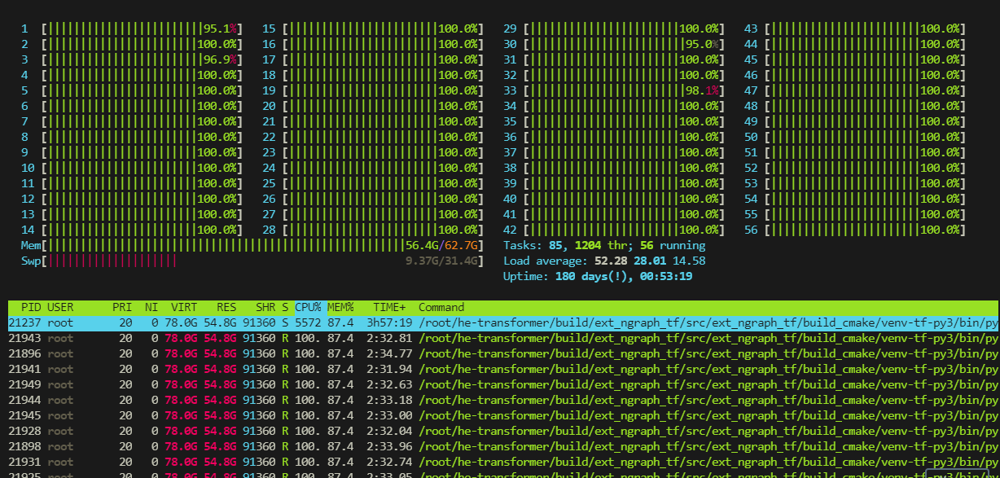

## Trying to simplify the model

In [41]:
def generator_model_simplified(activation):

    model = tf.keras.Sequential()
    model.add(layers.Dense(7*7*256, input_shape=(100,), name='input_gen'))
    model.add(Activation(activation)) ##Change with respect to previous

    model.add(layers.Reshape((7, 7, 256)))
    assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same'))
    model.add(layers.AveragePooling2D(pool_size=(3,3), strides=(1,1), padding='same'))
    assert model.output_shape == (None, 7, 7, 128)
    model.add(Activation(activation)) ##Change with respect to previous 

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.AveragePooling2D(pool_size=(3,3), strides=(1,1), padding='same'))
    assert model.output_shape == (None, 14, 14, 64)
    model.add(Activation(activation)) ##Change with respect to previous
    
    model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same',
                                     activation='tanh', name='output_gen'))
    #model.add(Activation(activation)) ##Change with respect to previous
    assert model.output_shape == (None, 28, 28, 1)
    model.compile(loss='binary_crossentropy', optimizer='sgd')
    
    return model


def discriminator_model_simplified(activation):

    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[28, 28, 1], name='input_disc'))
    model.add(Activation(activation)) ##Change with respect to previous
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(Activation(activation)) ##Change with respect to previous
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1, activation='sigmoid', name='output_disc'))
    #model.add(Activation(activation)) ##Change with respect to previous
    model.compile(loss='binary_crossentropy', 
                  optimizer='sgd',
                  metrics=['accuracy'])
    return model


def gan_model_simplified(generator, discriminator):
    discriminator.trainable=False
    gan_input = Input(shape=(100,))
    x = generator(gan_input)
    gan_output = discriminator(x)
    gan= Model(inputs=gan_input, outputs=gan_output)
    #gan.compile(loss='binary_crossentropy', optimizer='adam')
    gan.compile(loss='binary_crossentropy', 
                optimizer='sgd')
    return gan
            
              
def test_activation_function_simplified(function):
    generator_act = lambda: generator_model_simplified(function)
    dicriminator_act = lambda: discriminator_model_simplified(function)
    gan_act = gan_model_simplified
    return generator_act, dicriminator_act, gan_act

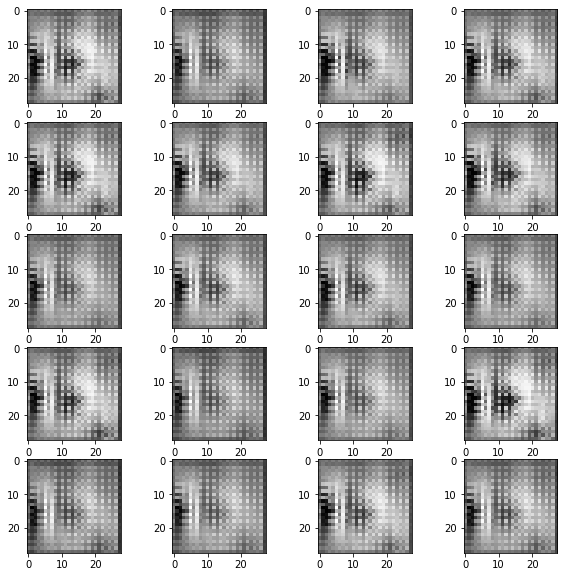

Time for epoch 50 is 14.677250623703003 sec


In [42]:
gen_model_act, disc_mod_act, gan_mod_act = test_activation_function_simplified(square_activation)
animation6 = full_training(gen_model_act, disc_mod_act, gan_mod_act, 5000, 50, 32, 'square_simple')

# Looking inside the activations

In this section, we try to take a look at the inner part of the activation functions

In [140]:
generator, discriminator = None, None

def my_event_handler(btn_object):
    global generator, discriminator
    # Clear output and select a new model.
    display.clear_output(wait=True)
    display_models()
    model = btn_object.description
    print("Loading %s model..." % (model), end='\r')
    
    custom_functions = {'relu_regression_2': relu_regression_2,
                        'relu_regression_15': relu_regression_15,
                        'taylor_sigmoid': taylor_sigmoid,
                        'square_activation': square_activation}
    # Reset the graph and backend learning phase.
    tf.reset_default_graph()
    tf.keras.backend.set_learning_phase(0)
    
    # Load generator as H5
    generator = tf.keras.models.load_model('models/%s/generator.h5' % (model), 
                                           custom_objects=custom_functions)
    discriminator = tf.keras.models.load_model('models/%s/discriminator.h5' % (model), 
                                           custom_objects=custom_functions)
    print("Loaded %s model    " % (model))


def display_models():
    print("Click on a model to execute it on a private input:")
    dirs = os.listdir( 'models/' )
    for d in dirs:
        btn = widgets.Button(description=d)
        btn.on_click(my_event_handler)
        display.display(btn)
        
display_models()   

Click on a model to execute it on a private input:


Button(description='basic_1', style=ButtonStyle())

Button(description='square', style=ButtonStyle())

Button(description='taylor_sigmoid', style=ButtonStyle())

Button(description='relu_regression_2', style=ButtonStyle())

Button(description='relu_regression_15', style=ButtonStyle())

Button(description='square2', style=ButtonStyle())

Button(description='square_simple', style=ButtonStyle())

Loaded square2 model    


In [136]:
def print_intermediate_steps(model, test_activations, layer_interval):
    layer_outputs = [layer.output for layer in model.layers[layer_interval[0]:layer_interval[1]]]
    activation_model = Model(inputs=model.input,outputs=layer_outputs)
    activations = activation_model.predict(test_activations)
    #print("·$")
    layer_names = []
    for layer in model.layers[layer_interval[0]:layer_interval[1]]:
        layer_names.append(layer.name) # Names of the layers, so you can have them as part of your plot

    images_per_row = 16
    for layer_name, layer_activation in zip(layer_names, activations): # Displays the feature maps
        #print("Layer: %s" %(layer_name))
        try:
            if not ('activation' in layer_name or 
                    'conv' in layer_name or
                    're_lu' in layer_name or
                    'input_disc' in layer_name or 
                    'output_gen' in layer_name):
                continue
            n_features = layer_activation.shape[-1] # Number of features in the feature map
            size = layer_activation.shape[1] #The feature map has shape (1, size, size, n_features).
            n_cols = n_features // images_per_row # Tiles the activation channels in this matrix
            display_grid = np.zeros((size * n_cols, images_per_row * size))

            for col in range(n_cols): # Tiles each filter into a big horizontal grid
                for row in range(images_per_row):
                    channel_image = layer_activation[0,
                                                     :, :,
                                                     col * images_per_row + row]
                    channel_image -= channel_image.mean() # Post-processes the feature to make it visually palatable
                    channel_image /= channel_image.std()
                    channel_image *= 64
                    channel_image += 128
                    channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                    display_grid[col * size : (col + 1) * size, # Displays the grid
                                 row * size : (row + 1) * size] = channel_image
            scale = 1. / size
            plt.figure(figsize=(scale * display_grid.shape[1],
                                scale * display_grid.shape[0]))
            plt.title(layer_name)
            plt.grid(False)
            plt.imshow(display_grid, aspect='auto', cmap='viridis')
        except (RuntimeError):
            print("ERROR ON LAYER: %s" % (layer_name))
            print(RuntimeError)


In [115]:
real_dataset = preprocess_real_samples(np.load('apple.npy'))


In [142]:
noise = np.random.normal(0, 1, (1, 100))

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_gen (Dense)            (None, 12544)             1254400   
_________________________________________________________________
batch_normalization_3 (Batch (None, 12544)             50176     
_________________________________________________________________
activation_5 (Activation)    (None, 12544)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 7, 7, 256)         0         
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 7, 7, 128)         819200    
_________________________________________________________________
batch_normalization_4 (Batch (None, 7, 7, 128)         512       
_________________________________________________________________
activation_6 (Activation)    (None, 7, 7, 128)        

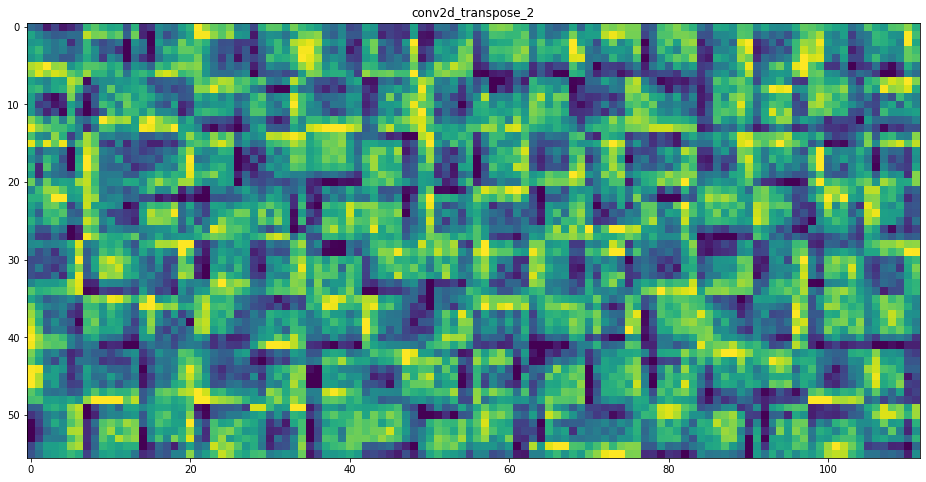

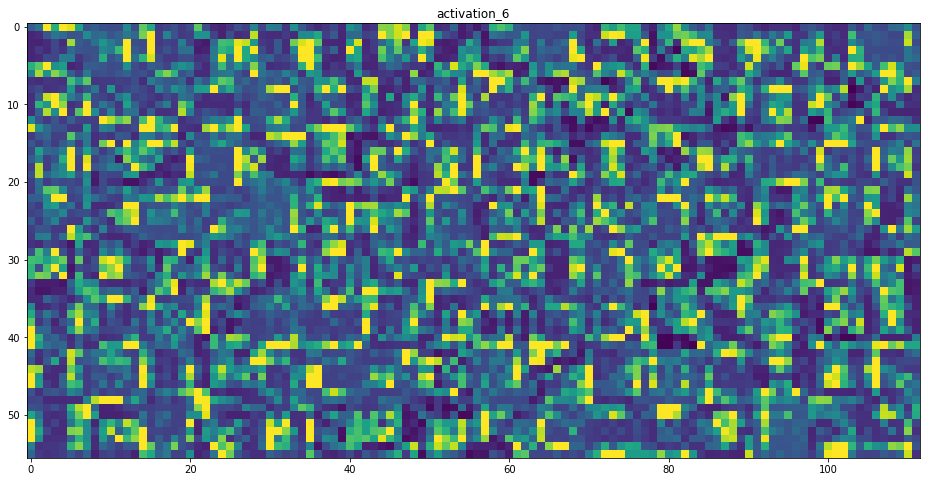

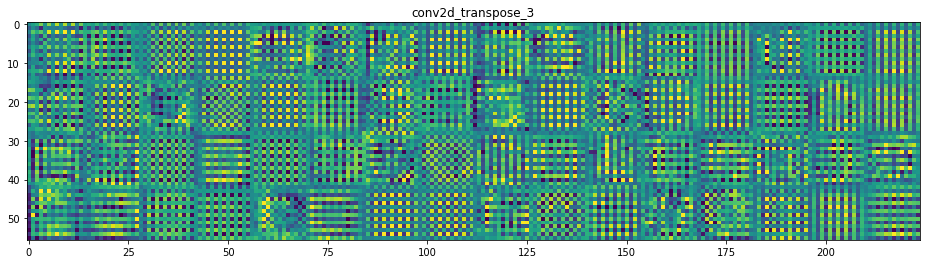

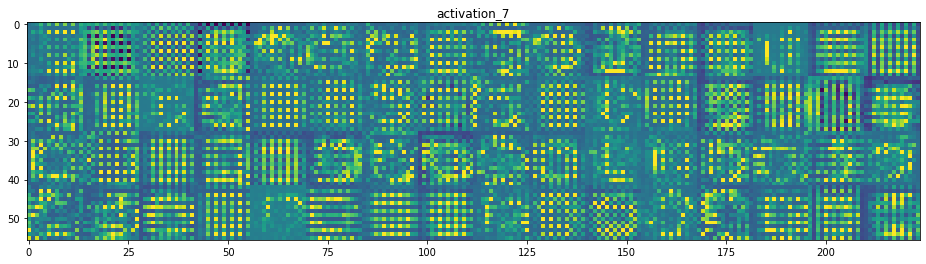

In [141]:
generator.summary()
print_intermediate_steps(generator, noise, (4, 10))

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_disc (Conv2D)          (None, 14, 14, 64)        1664      
_________________________________________________________________
activation_8 (Activation)    (None, 14, 14, 64)        0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 7, 7, 128)         204928    
_________________________________________________________________
activation_9 (Activation)    (None, 7, 7, 128)         0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 7, 7, 128)         0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 6272)             

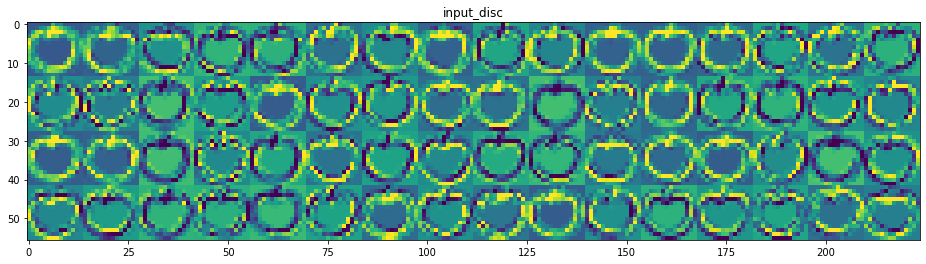

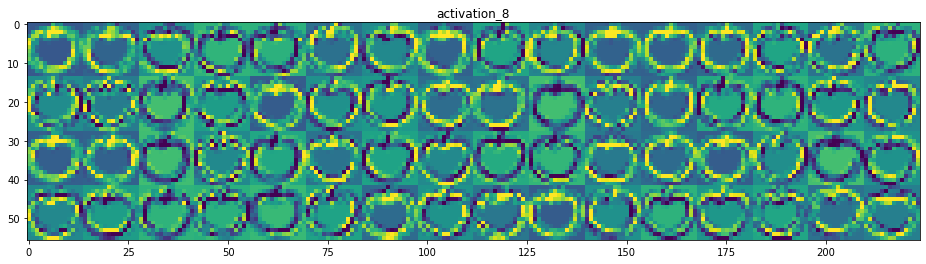

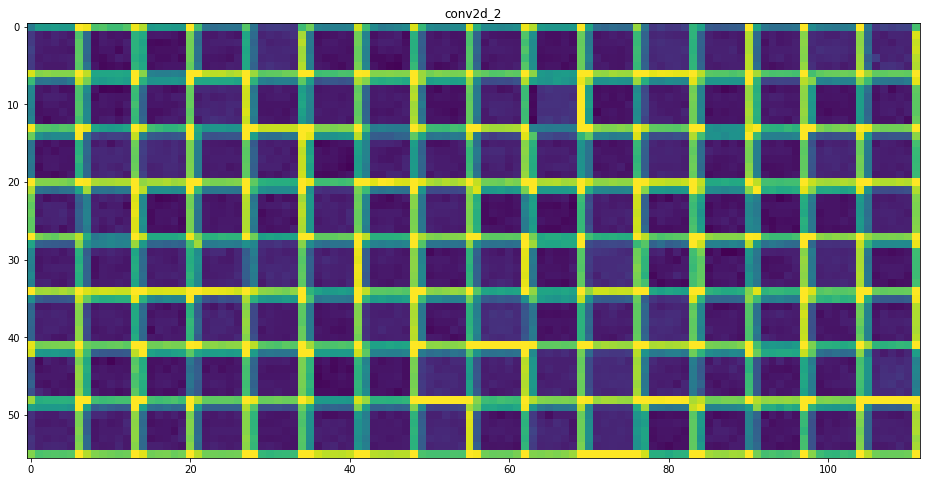

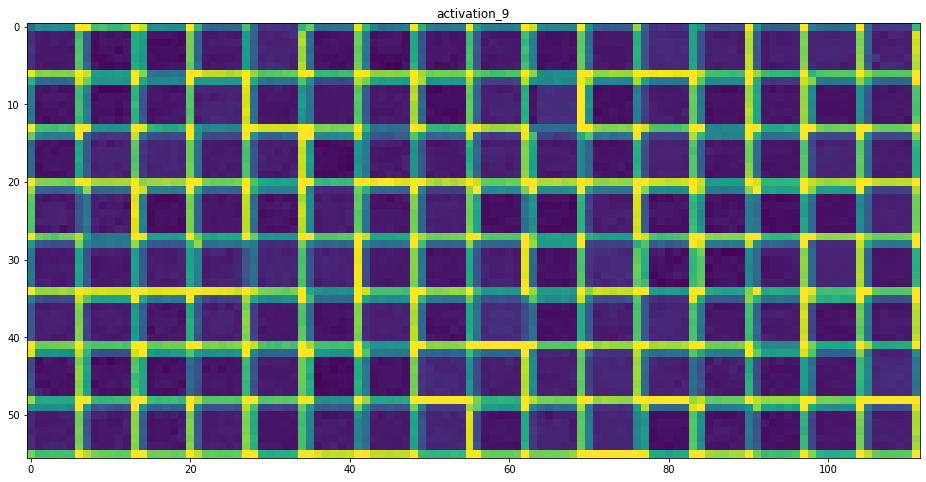

In [132]:
discriminator.summary()
print_intermediate_steps(discriminator, real_dataset[3:4], (0, 8))

Click on a model to execute it on a private input:


Button(description='basic_1', style=ButtonStyle())

Button(description='square', style=ButtonStyle())

Button(description='taylor_sigmoid', style=ButtonStyle())

Button(description='relu_regression_2', style=ButtonStyle())

Button(description='relu_regression_15', style=ButtonStyle())

Button(description='square2', style=ButtonStyle())

Button(description='square_simple', style=ButtonStyle())

Loaded relu_regression_15 model    


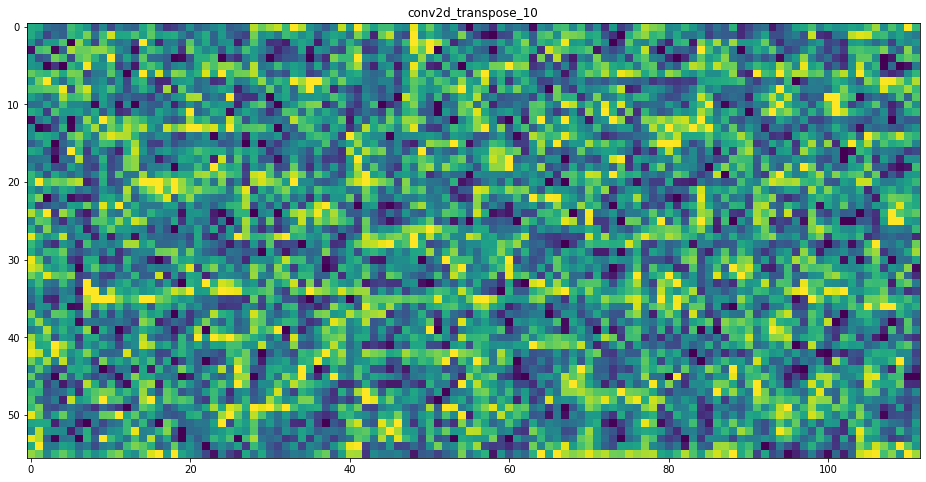

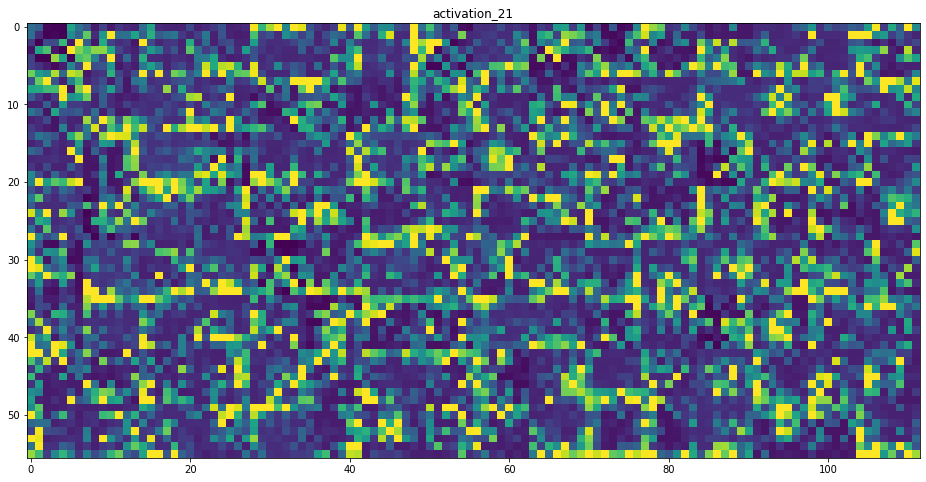

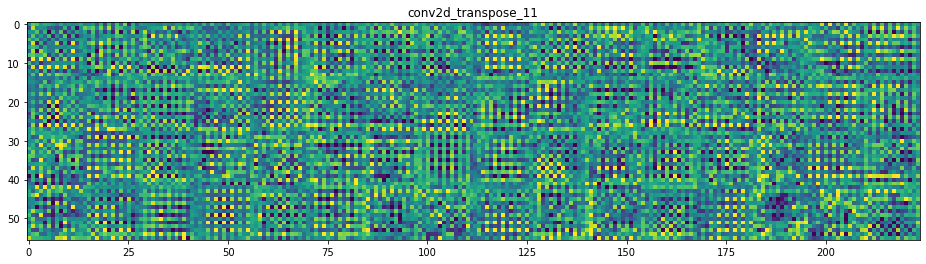

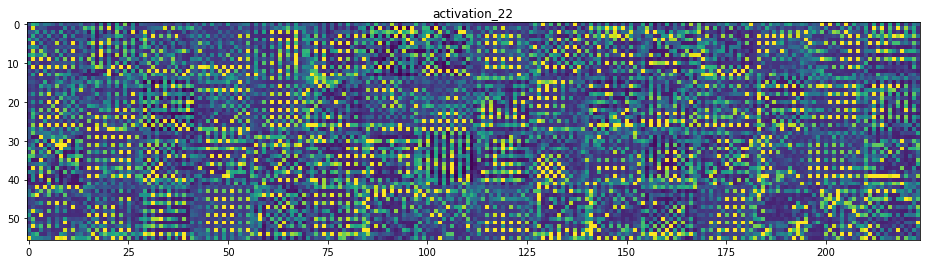

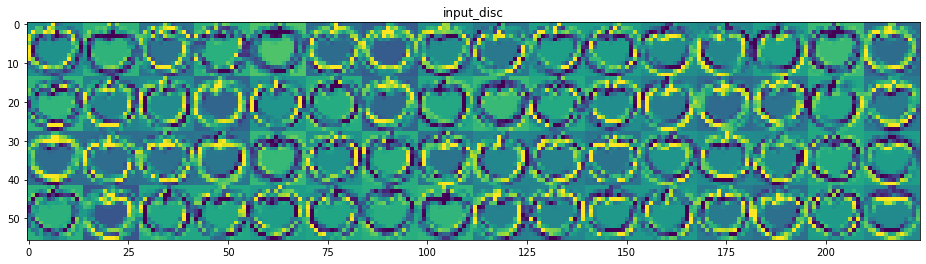

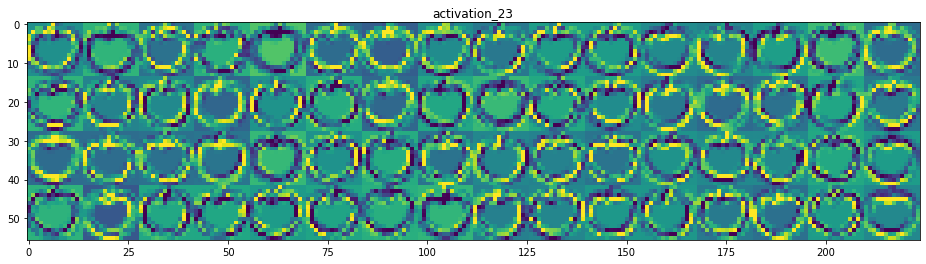

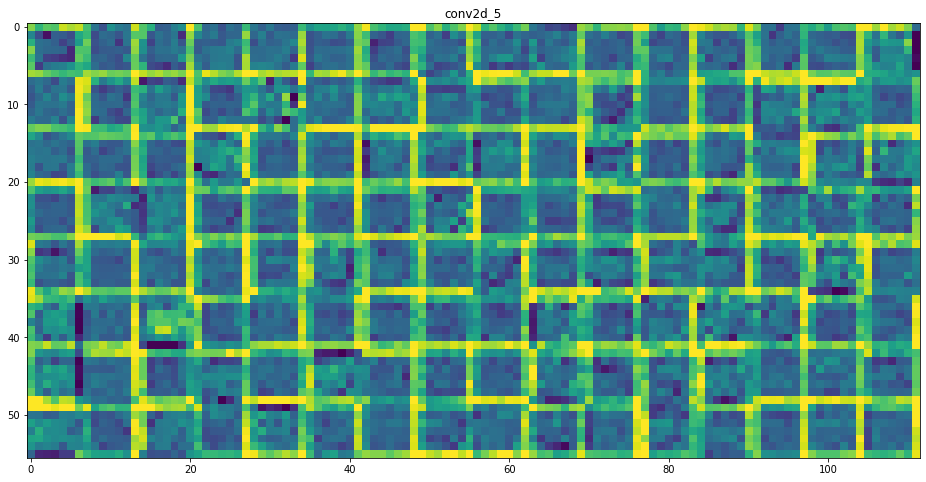

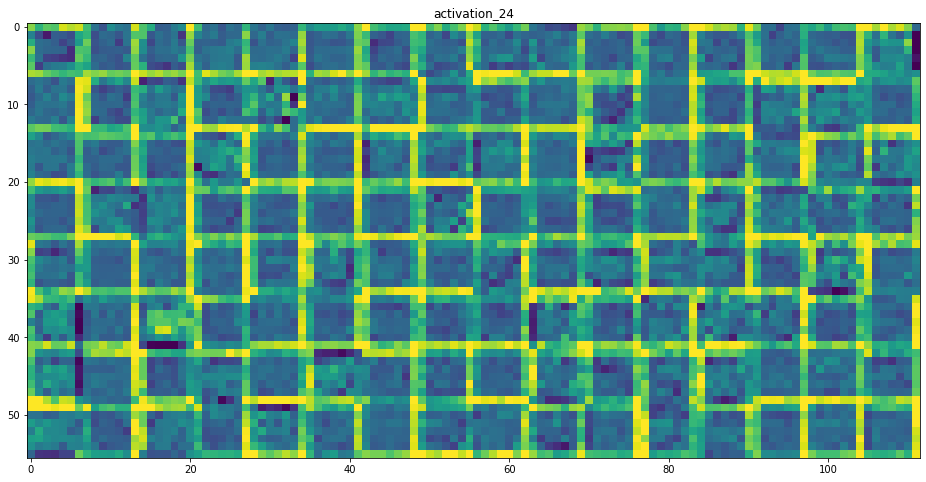

In [137]:
def my_event_handler(btn_object):

    # Clear output and select a new model.
    display.clear_output(wait=True)
    display_models()
    model = btn_object.description
    print("Loading %s model..." % (model), end='\r')
    
    custom_functions = {'relu_regression_2': relu_regression_2,
                        'relu_regression_15': relu_regression_15,
                        'taylor_sigmoid': taylor_sigmoid,
                        'square_activation': square_activation}
    # Reset the graph and backend learning phase.
    tf.reset_default_graph()
    tf.keras.backend.set_learning_phase(0)
    
    # Load generator as H5
    generator = tf.keras.models.load_model('models/%s/generator.h5' % (model), 
                                           custom_objects=custom_functions)
    discriminator = tf.keras.models.load_model('models/%s/discriminator.h5' % (model), 
                                           custom_objects=custom_functions)
    print("Loaded %s model    " % (model))
    print_intermediate_steps(generator, noise, (4, 10))
    
    print_intermediate_steps(discriminator, real_dataset[3:10], (0, 8))
    


def display_models():
    print("Click on a model to execute it on a private input:")
    dirs = os.listdir( 'models/' )
    for d in dirs:
        btn = widgets.Button(description=d)
        btn.on_click(my_event_handler)
        display.display(btn)
        
display_models()   